In [1]:
import os
import torch
from model import Classifier

# Definir a variável de ambiente CUDA_VISIBLE_DEVICES
os.environ["CUDA_VISIBLE_DEVICES"] = "7"

class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 7 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'UCI_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/3_dataset/UCI_MotionSense_KuHar_RealWorld_k_28_lr_0.0005_bs_64.pkl'  # Substitua pelo caminho do modelo pré-treinado
        self.data_percentage = 100
args = Args()

# Verifique se o dispositivo está configurado corretamente
print(f'Usando o dispositivo: {args.device}')

classifier_model = Classifier(args)
# Carregar os pesos pré-treinados
classifier_model.load_pretrained_weights(args)
# Colocar o modelo em modo de avaliação
classifier_model.eval()


Usando o dispositivo: cuda
Loading the pre-trained weights


Classifier(
  (encoder): CPC(
    (encoder): Encoder(
      (encoder): Convolutional1DEncoder(
        (encoder): Sequential(
          (0): ConvBlock(
            (conv): Conv1d(6, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (1): ConvBlock(
            (conv): Conv1d(32, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (2): ConvBlock(
            (conv): Conv1d(64, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
        )
      )
    )
    (rnn): GRU(128, 256, num_layers=2, batch_first=True, dropout=0.2)
    (Wk): ModuleList(
      (0-27): 28 x PredictionNetwork(
        (Wk): Linear(in_

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import numpy as np
import pandas as pd
from pathlib import Path
from dataset import load_dataset
# import TSNE
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt


In [3]:
# Passo 1: Obtenha os embeddings com o modelo pré-treinado
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

subset_train = data_loaders['train'].dataset.dataset  # Acessando o conjunto de dados original
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

embeddings = classifier_model.predict_features(inputs)
embeddings = embeddings.flatten(start_dim=1)
print("Embeddings", embeddings.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings.detach().numpy())


Data Raw (528157, 6)
Data (21125, 50, 6)
Labels (21125,)
Data Raw (73075, 6)
Data (2922, 50, 6)
Labels (2922,)
Data Raw (148030, 6)
Data (5920, 50, 6)
Labels (5920,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 21125, 'val': 2922, 'test': 5920}
Dataset size for train: 21125
Dataset size for val: 2922
Dataset size for test: 5920
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fbc28f8e140>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fbc28526e90>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d91dee00>}
Embeddings torch.Size([21125, 12800])


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

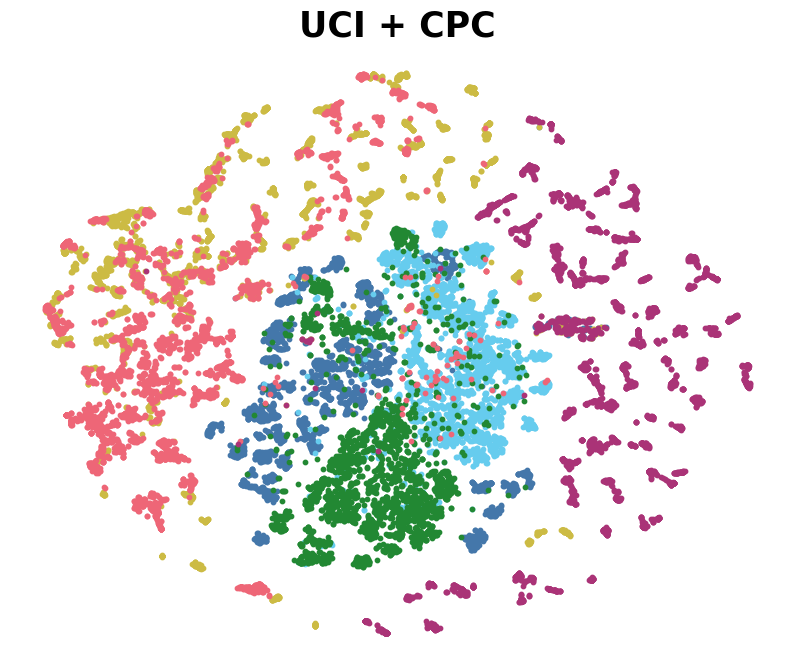

In [7]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'walking', 1: 'walking_upstairs', 2: 'walking_downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
#plt.legend(fontsize=12)
plt.title('UCI + CPC', fontsize=25, fontweight='bold') 

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.axis('off')

# Salvar a figura

plt.savefig('UCI_CPC.png', dpi=300)

plt.show()


In [6]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from dataset import load_dataset
from sklearn.manifold import TSNE

# Passo 1: Obtenha os dados brutos
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

# Converter para numpy array
inputs_np = inputs.detach().numpy()

# Aplicar FFT em cada uma das dimensões
fft_inputs = np.fft.fft(inputs_np, axis=1)  # Apply FFT along the second dimension
fft_magnitude = np.abs(fft_inputs)

print("FFT Magnitude", fft_magnitude.shape)

# Flatten the FFT magnitude array
embeddings = fft_magnitude.reshape(fft_magnitude.shape[0], -1)  # Flatten to (25241, 50*6)
print("Embeddings", embeddings.shape)

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings)


Data Raw (528157, 6)
Data (21125, 50, 6)
Labels (21125,)
Data Raw (73075, 6)
Data (2922, 50, 6)
Labels (2922,)
Data Raw (148030, 6)
Data (5920, 50, 6)
Labels (5920,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 21125, 'val': 2922, 'test': 5920}
Dataset size for train: 21125
Dataset size for val: 2922
Dataset size for test: 5920
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fbabf192aa0>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d97910f0>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d8ddb430>}
FFT Magnitude (21125, 50, 6)
Embeddings (21125, 300)


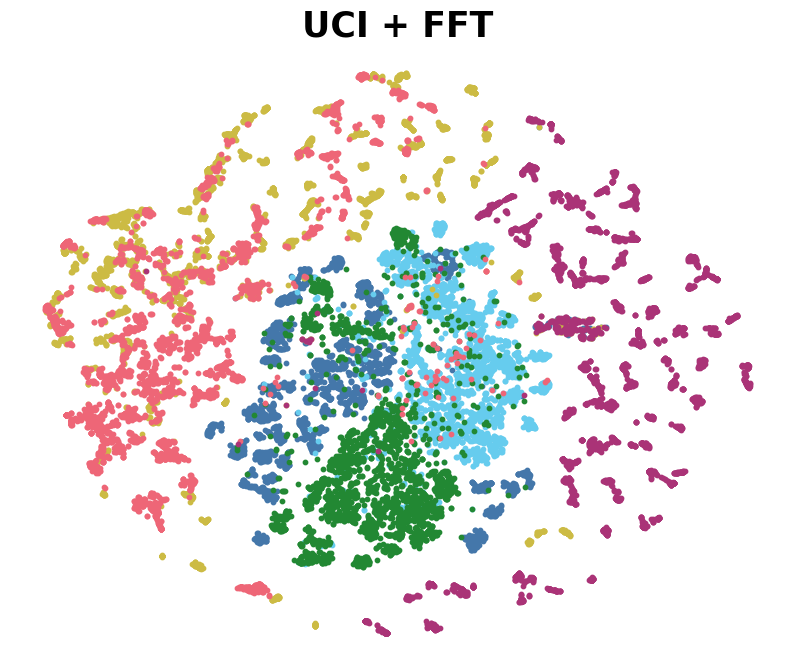

In [8]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'walking', 1: 'walking_upstairs', 2: 'walking_downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
#plt.legend(fontsize=12)
plt.title('UCI + FFT', fontsize=25, fontweight='bold') 

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.axis('off')

# Salvar a figura

plt.savefig('UCI_FFT.png', dpi=300)

plt.show()

In [12]:
# Passo 1: Obtenha os embeddings com DADOS BRUTOS
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

inputs = inputs.flatten(start_dim=1)

print("Embeddings", inputs.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(inputs.detach().numpy())


Data Raw (528157, 6)
Data (21125, 50, 6)
Labels (21125,)
Data Raw (73075, 6)
Data (2922, 50, 6)
Labels (2922,)
Data Raw (148030, 6)
Data (5920, 50, 6)
Labels (5920,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 21125, 'val': 2922, 'test': 5920}
Dataset size for train: 21125
Dataset size for val: 2922
Dataset size for test: 5920
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d8d31f60>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fbc28526890>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b859cdc0>}
Embeddings torch.Size([21125, 300])


Shape of embeddings_tsne: (21125, 2)
Shape of labels: (21125,)


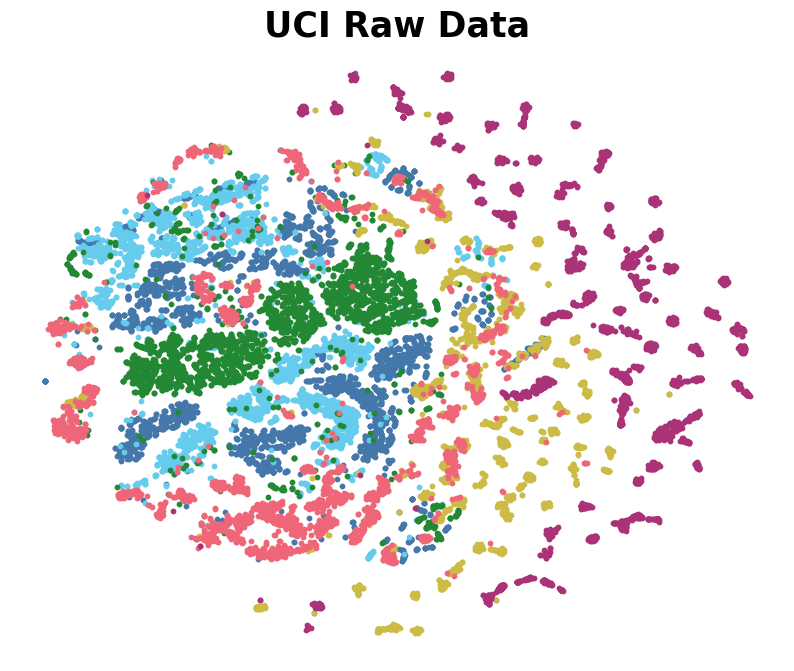

In [17]:
print("Shape of embeddings_tsne:", embeddings_tsne.shape)
print("Shape of labels:", labels.shape)

# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'walking', 1: 'walking_upstairs', 2: 'walking_downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}

plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')

#plt.legend(fontsize=12)
plt.title('UCI Raw Data', fontsize=25, fontweight='bold') 

plt.axis('off')

# Salvar a figura

plt.savefig('UCI_Raw.png', dpi=300)

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

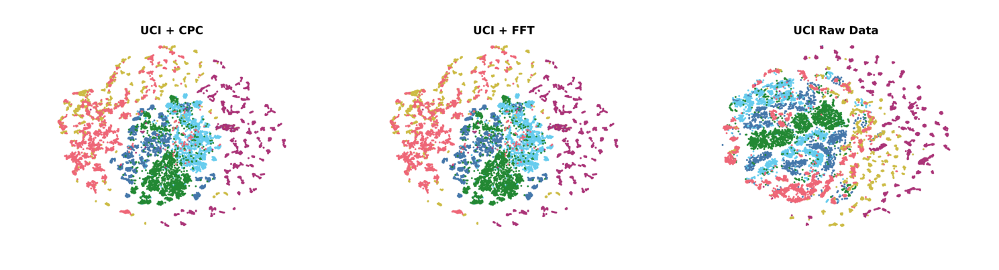

In [26]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

# Carregar as imagens
img1 = mpimg.imread('UCI_CPC.png')
img2 = mpimg.imread('UCI_FFT.png')
img3 = mpimg.imread('UCI_Raw.png')

# Criar um subplot com uma linha e três colunas
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Exibir as imagens nos subplots
axs[0].imshow(img1)
axs[0].axis('off')
#axs[0].set_title('UCI_CPC.png')

axs[1].imshow(img2)
axs[1].axis('off')
#axs[1].set_title('UCI_FFT.png')

axs[2].imshow(img3)
axs[2].axis('off')
#axs[2].set_title('UCI_Raw.png')

# Ajustar o layout
plt.tight_layout()

# Salvar a imagem combinada
#plt.savefig('combined_plot.png')

# Mostrar o plot
plt.show()


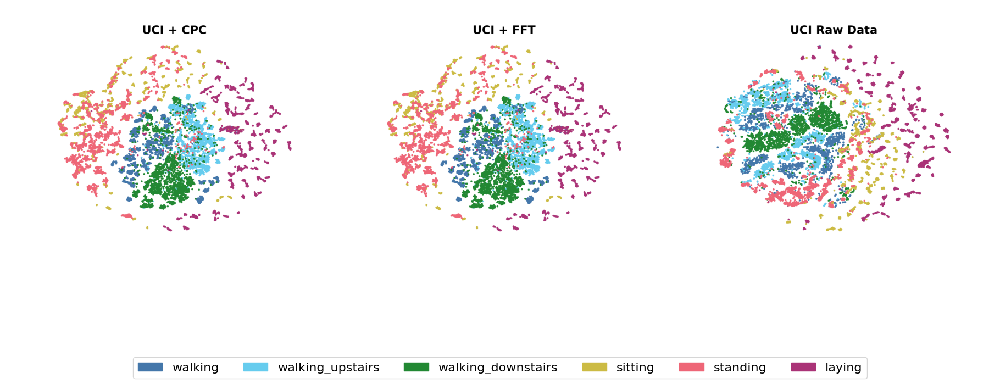

In [42]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as mpatches

# Carregar as imagens
img1 = mpimg.imread('UCI_CPC.png')
img2 = mpimg.imread('UCI_FFT.png')
img3 = mpimg.imread('UCI_Raw.png')

# Cores e dicionário de atividades
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
activities = {0: 'walking', 1: 'walking_upstairs', 2: 'walking_downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}

# Criar um subplot com uma linha e três colunas
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# Exibir as imagens nos subplots
axs[0].imshow(img1)
axs[0].axis('off')
# axs[0].set_title('UCI_CPC.png', fontsize=12)

axs[1].imshow(img2)
axs[1].axis('off')
# axs[1].set_title('UCI_FFT.png', fontsize=12)

axs[2].imshow(img3)
axs[2].axis('off')
# axs[2].set_title('UCI_Raw.png', fontsize=12)

# Adicionar a legenda com pontos coloridos
legend_elements = [mpatches.Patch(color=colors[i], label=activities[i]) for i in range(len(activities))]
plt.figlegend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=6, fontsize=16)

# Ajustar o layout
plt.tight_layout(pad=0.0, rect=[0, 0.1, 1, 1])

# Salvar a imagem combinada
#plt.savefig('uci_tsne.png')

# Mostrar o plot
plt.show()


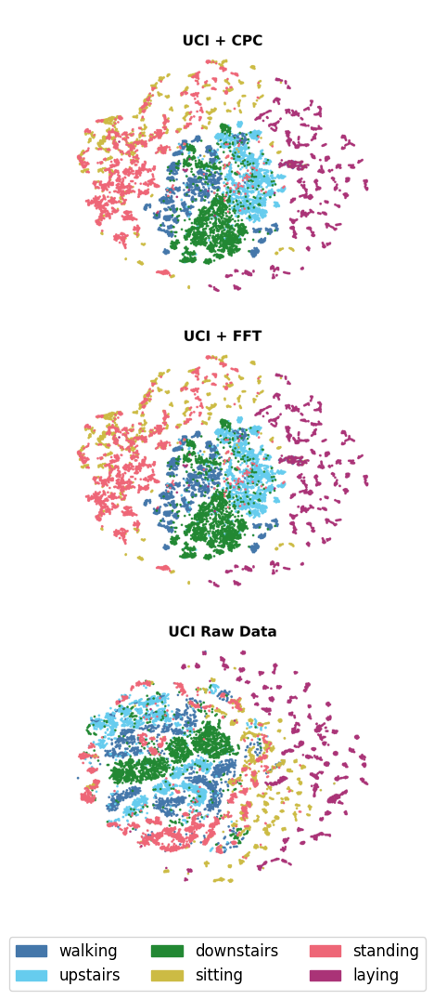

In [77]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as mpatches

# Carregar as imagens
img1 = mpimg.imread('UCI_CPC.png')
img2 = mpimg.imread('UCI_FFT.png')
img3 = mpimg.imread('UCI_Raw.png')

# Cores e dicionário de atividades
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
activities = {0: 'walking', 1: 'upstairs', 2: 'downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}

# Criar um subplot com uma coluna e três linhas
fig, axs = plt.subplots(3, 1, figsize=(6, 18))  # Ajustar o tamanho da figura para ter mais altura

# Exibir as imagens nos subplots
axs[0].imshow(img1)
axs[0].axis('off')
#axs[0].set_title('UCI_CPC.png', fontsize=12)

axs[1].imshow(img2)
axs[1].axis('off')
#axs[1].set_title('UCI_FFT.png', fontsize=12)

axs[2].imshow(img3)
axs[2].axis('off')
#axs[2].set_title('UCI_Raw.png', fontsize=12)

# Adicionar a legenda com pontos coloridos
legend_elements = [mpatches.Patch(color=colors[i], label=activities[i]) for i in range(len(activities))]
plt.figlegend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, 0.05), ncol=3, fontsize=12)

# Ajustar o layout
plt.tight_layout(pad=0, rect=[0, 0.05, 1, .6])  # Ajuste o `rect` para dar espaço para a legenda

# Salvar a imagem combinada
plt.savefig('uci_tsne_column.png')

# Mostrar o plot
plt.show()


In [49]:
#             # Passo 3: Plote os embeddings no gráfico t-SNE
# colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
# dic = {0: 'walking', 1: 'walking_upstairs', 2: 'walking_downstairs', 3: 'sitting', 4: 'standing', 5: 'laying'}
# plt.figure(figsize=(10, 8))
# for i in range(6):
#     plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
# #plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
# #plt.colorbar()
# plt.legend(fontsize=12)
# plt.title('UCI Raw Data', fontsize=25, fontweight='bold') 

# # Aumentar o tamanho dos números nos eixos x e y
# plt.xticks(fontsize=20, fontweight='bold')
# plt.yticks(fontsize=20, fontweight='bold')

# plt.show()

In [18]:
import os
import torch
from model import Classifier

# Definir a variável de ambiente CUDA_VISIBLE_DEVICES
os.environ["CUDA_VISIBLE_DEVICES"] = "7"

class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 6 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'MotionSense_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/3_dataset/UKM_k_28_lr_0.0005_bs_64.pkl'
        self.data_percentage = 100
args = Args()

# Verifique se o dispositivo está configurado corretamente
print(f'Usando o dispositivo: {args.device}')

classifier_model = Classifier(args)
# Carregar os pesos pré-treinados
classifier_model.load_pretrained_weights(args)
# Colocar o modelo em modo de avaliação
classifier_model.eval()


Usando o dispositivo: cuda
Loading the pre-trained weights


Classifier(
  (encoder): CPC(
    (encoder): Encoder(
      (encoder): Convolutional1DEncoder(
        (encoder): Sequential(
          (0): ConvBlock(
            (conv): Conv1d(6, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (1): ConvBlock(
            (conv): Conv1d(32, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (2): ConvBlock(
            (conv): Conv1d(64, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
        )
      )
    )
    (rnn): GRU(128, 256, num_layers=2, batch_first=True, dropout=0.2)
    (Wk): ModuleList(
      (0-27): 28 x PredictionNetwork(
        (Wk): Linear(in_

In [19]:
# Passo 1: Obtenha os embeddings com o modelo pré-treinado
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

subset_train = data_loaders['train'].dataset.dataset  # Acessando o conjunto de dados original
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

embeddings = classifier_model.predict_features(inputs)
embeddings = embeddings.flatten(start_dim=1)
print("Embeddings", embeddings.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings.detach().numpy())


Data Raw (1002693, 6)
Data (40106, 50, 6)
Labels (40106,)
Data Raw (116283, 6)
Data (4650, 50, 6)
Labels (4650,)
Data Raw (293889, 6)
Data (11754, 50, 6)
Labels (11754,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 40106, 'val': 4650, 'test': 11754}
Dataset size for train: 40106
Dataset size for val: 4650
Dataset size for test: 11754
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3f81930>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b84938b0>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b8667520>}
Embeddings torch.Size([40106, 12800])


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

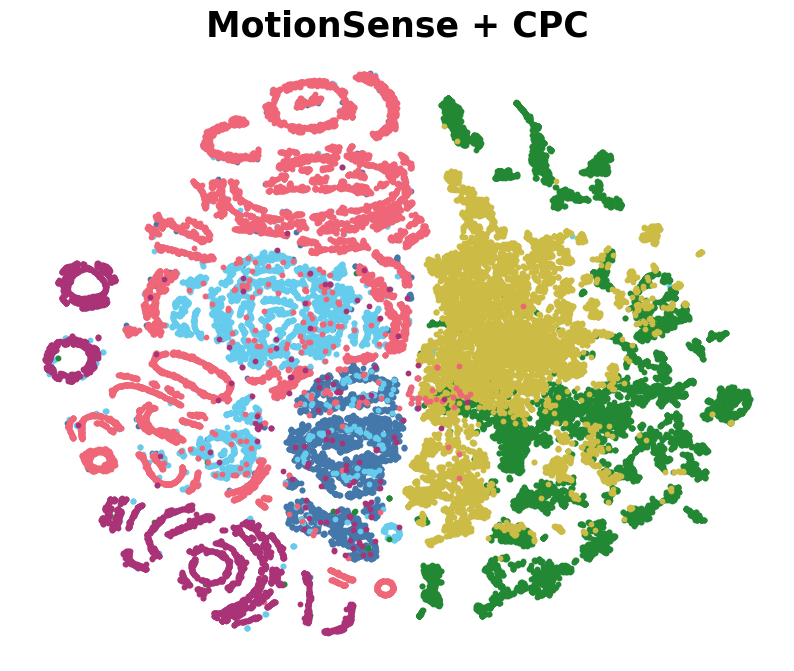

In [21]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'downstairs', 1: 'upstairs', 2: 'sitting', 3: 'standing', 4: 'walking', 5: 'jogging'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i, 0], embeddings_tsne[labels == i, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
#plt.legend(fontsize=12)
plt.title('MotionSense + CPC', fontsize=25, fontweight='bold')

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.axis('off')

# Salvar a figura

plt.savefig('MotionSense_CPC.png', dpi=300)

plt.show()

In [22]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from dataset import load_dataset
from sklearn.manifold import TSNE

# Passo 1: Obtenha os dados brutos
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

# Converter para numpy array
inputs_np = inputs.detach().numpy()

# Aplicar FFT em cada uma das dimensões
fft_inputs = np.fft.fft(inputs_np, axis=1)  # Apply FFT along the second dimension
fft_magnitude = np.abs(fft_inputs)

print("FFT Magnitude", fft_magnitude.shape)

# Flatten the FFT magnitude array
embeddings = fft_magnitude.reshape(fft_magnitude.shape[0], -1)  # Flatten to (25241, 50*6)
print("Embeddings", embeddings.shape)

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings)


Data Raw (1002693, 6)
Data (40106, 50, 6)
Labels (40106,)
Data Raw (116283, 6)
Data (4650, 50, 6)
Labels (4650,)
Data Raw (293889, 6)
Data (11754, 50, 6)
Labels (11754,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 40106, 'val': 4650, 'test': 11754}
Dataset size for train: 40106
Dataset size for val: 4650
Dataset size for test: 11754
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3b6a230>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3b69480>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3b6a590>}
FFT Magnitude (40106, 50, 6)
Embeddings (40106, 300)


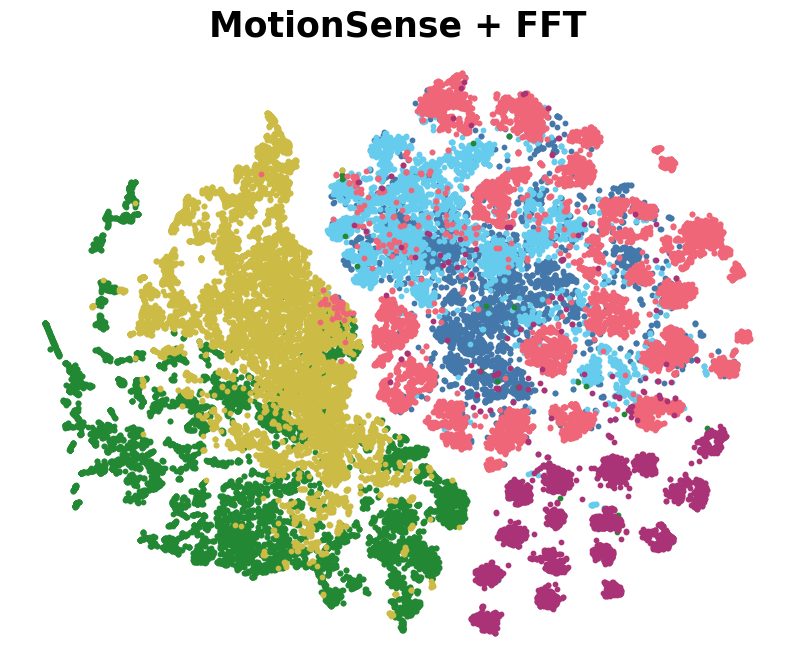

In [46]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'downstairs', 1: 'upstairs', 2: 'sitting', 3: 'standing', 4: 'walking', 5: 'jogging'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i, 0], embeddings_tsne[labels == i, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
#plt.legend(fontsize=12)
plt.title('MotionSense + FFT', fontsize=25, fontweight='bold')

plt.axis('off')

# Salvar a figura

plt.savefig('MotionSense_FFT.png', dpi=300)
# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')
plt.show()

In [47]:
# Passo 1: Obtenha os embeddings com DADOS BRUTOS
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

inputs = inputs.flatten(start_dim=1)

print("Embeddings", inputs.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(inputs.detach().numpy())

Data Raw (1002693, 6)
Data (40106, 50, 6)
Labels (40106,)
Data Raw (116283, 6)
Data (4650, 50, 6)
Labels (4650,)
Data Raw (293889, 6)
Data (11754, 50, 6)
Labels (11754,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 40106, 'val': 4650, 'test': 11754}
Dataset size for train: 40106
Dataset size for val: 4650
Dataset size for test: 11754
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3a1b0d0>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3b67580>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3b57760>}
Embeddings torch.Size([40106, 300])


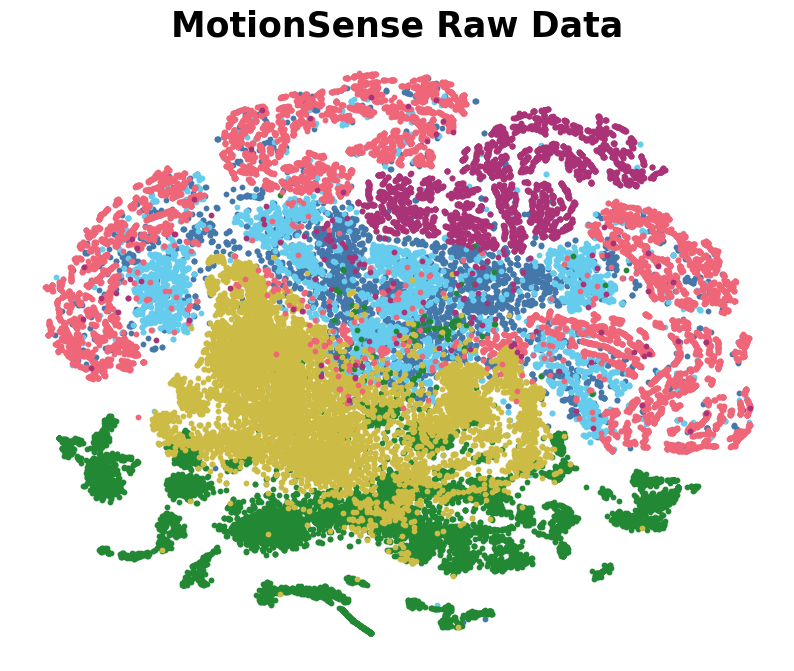

In [48]:
# Passo 3: Plote os embeddings no gráfico t-SNE
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
dic = {0: 'downstairs', 1: 'upstairs', 2: 'sitting', 3: 'standing', 4: 'walking', 5: 'jogging'}
plt.figure(figsize=(10, 8))
for i in range(6):
    plt.scatter(embeddings_tsne[labels == i, 0], embeddings_tsne[labels == i, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.scatter(embeddings_tsne[:, 0], embeddings_tsne[:, 1], s=10, c=labels, cmap='autumn')
#plt.colorbar()
#plt.legend(fontsize=12)
plt.title('MotionSense Raw Data', fontsize=25, fontweight='bold') 

plt.axis('off')

# Salvar a figura

plt.savefig('MotionSense_Raw.png', dpi=300)

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()


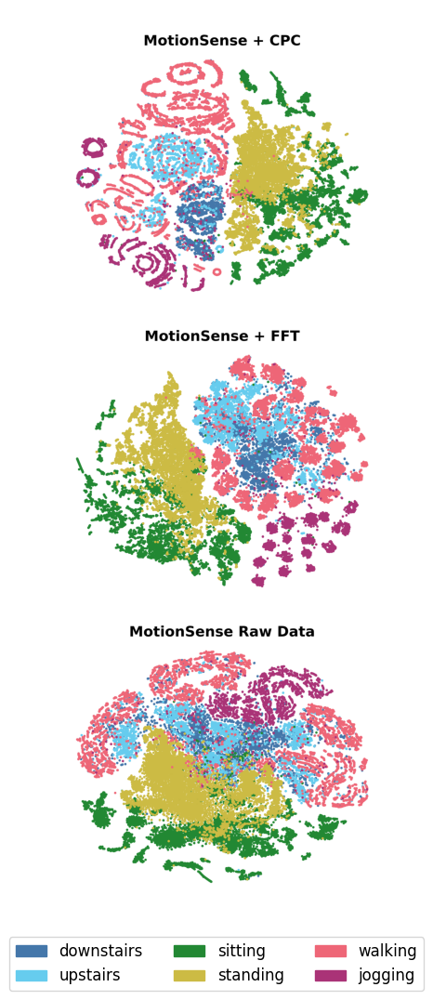

In [60]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as mpatches

# Carregar as imagens
img1 = mpimg.imread('MotionSense_CPC.png')
img2 = mpimg.imread('MotionSense_FFT.png')
img3 = mpimg.imread('MotionSense_Raw.png')

# Cores e dicionário de atividades
colors = ["#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377"]
activities = {0: 'downstairs', 1: 'upstairs', 2: 'sitting', 3: 'standing', 4: 'walking', 5: 'jogging'}

# Criar um subplot com uma coluna e três linhas
fig, axs = plt.subplots(3, 1, figsize=(6, 18))  # Ajustar o tamanho da figura para ter mais altura

# Exibir as imagens nos subplots
axs[0].imshow(img1)
axs[0].axis('off')
#axs[0].set_title('UCI_CPC.png', fontsize=12)

axs[1].imshow(img2)
axs[1].axis('off')
#axs[1].set_title('UCI_FFT.png', fontsize=12)

axs[2].imshow(img3)
axs[2].axis('off')
#axs[2].set_title('UCI_Raw.png', fontsize=12)

# Adicionar a legenda com pontos coloridos
legend_elements = [mpatches.Patch(color=colors[i], label=activities[i]) for i in range(len(activities))]
plt.figlegend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, 0.05), ncol=3, fontsize=12)

# Ajustar o layout
plt.tight_layout(pad=0, rect=[0, 0.05, 1, .6])  # Ajuste o `rect` para dar espaço para a legenda

# Salvar a imagem combinada
plt.savefig('motionsense_tsne_column.png')

# Mostrar o plot
plt.show()


In [64]:
import os
import torch
from model import Classifier

# Definir a variável de ambiente CUDA_VISIBLE_DEVICES
os.environ["CUDA_VISIBLE_DEVICES"] = "7"

class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 18 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'KuHar_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/May-26-2024/KuHar_MotionSense_k_28_lr_0.0005_bs_64.pkl'
        self.data_percentage = 100
args = Args()

# Verifique se o dispositivo está configurado corretamente
print(f'Usando o dispositivo: {args.device}')

classifier_model = Classifier(args)
# Carregar os pesos pré-treinados
classifier_model.load_pretrained_weights(args)
# Colocar o modelo em modo de avaliação
classifier_model.eval()


Usando o dispositivo: cuda
Loading the pre-trained weights


Classifier(
  (encoder): CPC(
    (encoder): Encoder(
      (encoder): Convolutional1DEncoder(
        (encoder): Sequential(
          (0): ConvBlock(
            (conv): Conv1d(6, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (1): ConvBlock(
            (conv): Conv1d(32, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (2): ConvBlock(
            (conv): Conv1d(64, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
        )
      )
    )
    (rnn): GRU(128, 256, num_layers=2, batch_first=True, dropout=0.2)
    (Wk): ModuleList(
      (0-27): 28 x PredictionNetwork(
        (Wk): Linear(in_

In [65]:
# Passo 1: Obtenha os embeddings com o modelo pré-treinado
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

subset_train = data_loaders['train'].dataset.dataset  # Acessando o conjunto de dados original
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

embeddings = classifier_model.predict_features(inputs)
embeddings = embeddings.flatten(start_dim=1)
print("Embeddings", embeddings.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings.detach().numpy())


Data Raw (2326845, 6)
Data (93072, 50, 6)
Labels (93072,)
Data Raw (309318, 6)
Data (12371, 50, 6)
Labels (12371,)
Data Raw (513087, 6)
Data (20522, 50, 6)
Labels (20522,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 93072, 'val': 12371, 'test': 20522}
Dataset size for train: 93072
Dataset size for val: 12371
Dataset size for test: 20522
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6df9c30>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6df9bd0>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6df83d0>}
Embeddings torch.Size([93072, 12800])


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

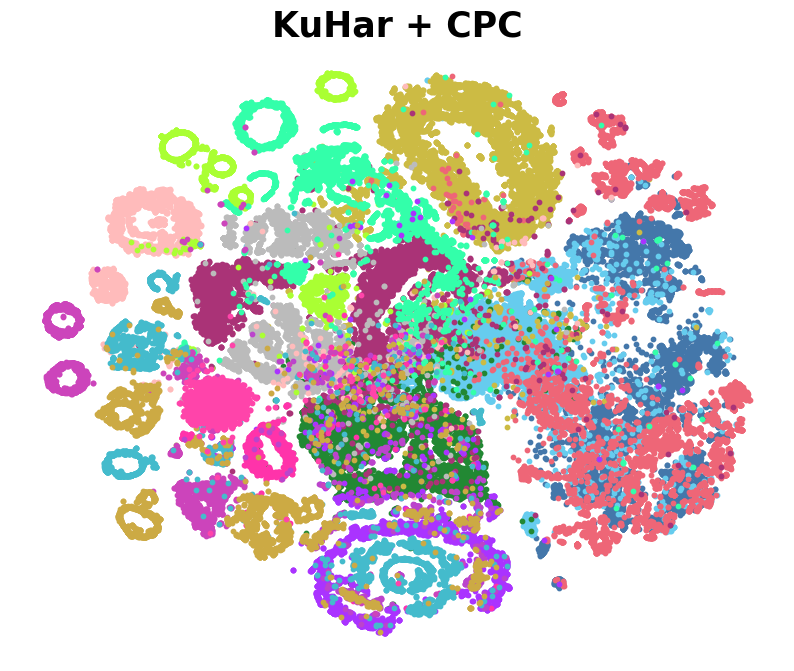

In [68]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377", 
    "#BBBBBB", "#FFBBBB", "#AAFF33", "#33FFAA", "#AA33FF", "#FF33AA",
    "#BB44CC", "#CC44BB", "#44BBCC", "#CCAA44", "#FF44AA", "#AAFF44"
]
dic = {
    0: 'stand', 1: 'sit', 2: 'talk-sit', 3: 'talk-stand', 4: 'stand-sit', 5: 'lay', 6: 'lay-stand',
    7: 'pick', 8: 'jump', 9: 'push-up', 10: 'sit-up', 11: 'walk', 
    12: 'walk-backward', 13: 'walk-circle', 14: 'run', 15: 'stair-up', 16: 'stair-down', 17: 'table-tennis'
}
plt.figure(figsize=(10, 8))
for i in range(18):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
plt.title('KuHar + CPC', fontsize=25, fontweight='bold') 
#plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))

plt.axis('off')

# Salvar a figura

plt.savefig('KuHar_CPC.png', dpi=300)

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [69]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from dataset import load_dataset
from sklearn.manifold import TSNE

# Passo 1: Obtenha os dados brutos
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

# Converter para numpy array
inputs_np = inputs.detach().numpy()

# Aplicar FFT em cada uma das dimensões
fft_inputs = np.fft.fft(inputs_np, axis=1)  # Apply FFT along the second dimension
fft_magnitude = np.abs(fft_inputs)

print("FFT Magnitude", fft_magnitude.shape)

# Flatten the FFT magnitude array
embeddings = fft_magnitude.reshape(fft_magnitude.shape[0], -1)  # Flatten to (25241, 50*6)
print("Embeddings", embeddings.shape)

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings)


Data Raw (2326845, 6)
Data (93072, 50, 6)
Labels (93072,)
Data Raw (309318, 6)
Data (12371, 50, 6)
Labels (12371,)
Data Raw (513087, 6)
Data (20522, 50, 6)
Labels (20522,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 93072, 'val': 12371, 'test': 20522}
Dataset size for train: 93072
Dataset size for val: 12371
Dataset size for test: 20522
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6fe5a80>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6fe6380>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6fe7520>}
FFT Magnitude (93072, 50, 6)
Embeddings (93072, 300)


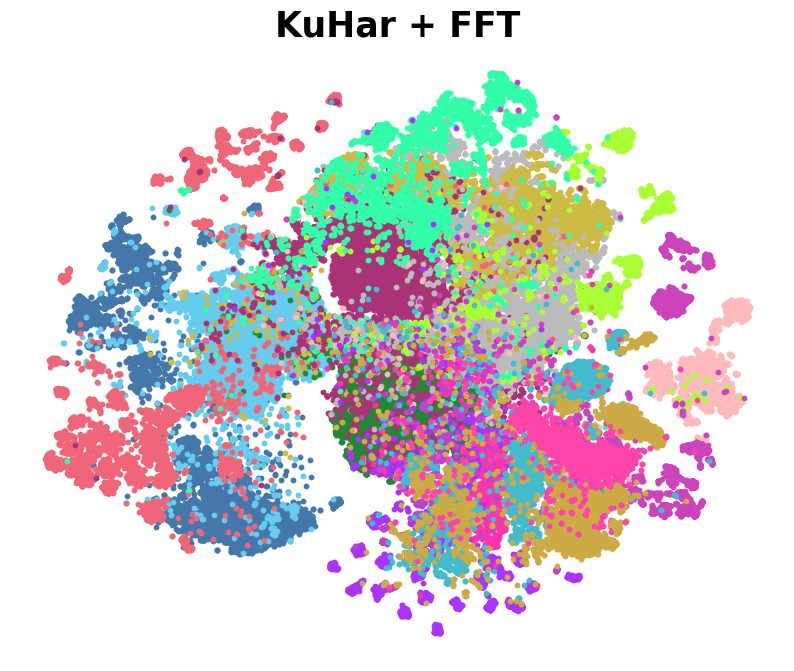

In [70]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377", 
    "#BBBBBB", "#FFBBBB", "#AAFF33", "#33FFAA", "#AA33FF", "#FF33AA",
    "#BB44CC", "#CC44BB", "#44BBCC", "#CCAA44", "#FF44AA", "#AAFF44"
]
dic = {
    0: 'stand', 1: 'sit', 2: 'talk-sit', 3: 'talk-stand', 4: 'stand-sit', 5: 'lay', 6: 'lay-stand',
    7: 'pick', 8: 'jump', 9: 'push-up', 10: 'sit-up', 11: 'walk', 
    12: 'walk-backward', 13: 'walk-circle', 14: 'run', 15: 'stair-up', 16: 'stair-down', 17: 'table-tennis'
}
plt.figure(figsize=(10, 8))
for i in range(18):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))
plt.title('KuHar + FFT', fontsize=25, fontweight='bold') 

plt.axis('off')

# Salvar a figura

plt.savefig('KuHar_FFT.png', dpi=300)

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

In [71]:
# Passo 1: Obtenha os embeddings com DADOS BRUTOS
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

inputs = inputs.flatten(start_dim=1)

print("Embeddings", inputs.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(inputs.detach().numpy())

Data Raw (2326845, 6)
Data (93072, 50, 6)
Labels (93072,)
Data Raw (309318, 6)
Data (12371, 50, 6)
Labels (12371,)
Data Raw (513087, 6)
Data (20522, 50, 6)
Labels (20522,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 93072, 'val': 12371, 'test': 20522}
Dataset size for train: 93072
Dataset size for val: 12371
Dataset size for test: 20522
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3aba170>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3abae30>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3ab8d00>}
Embeddings torch.Size([93072, 300])


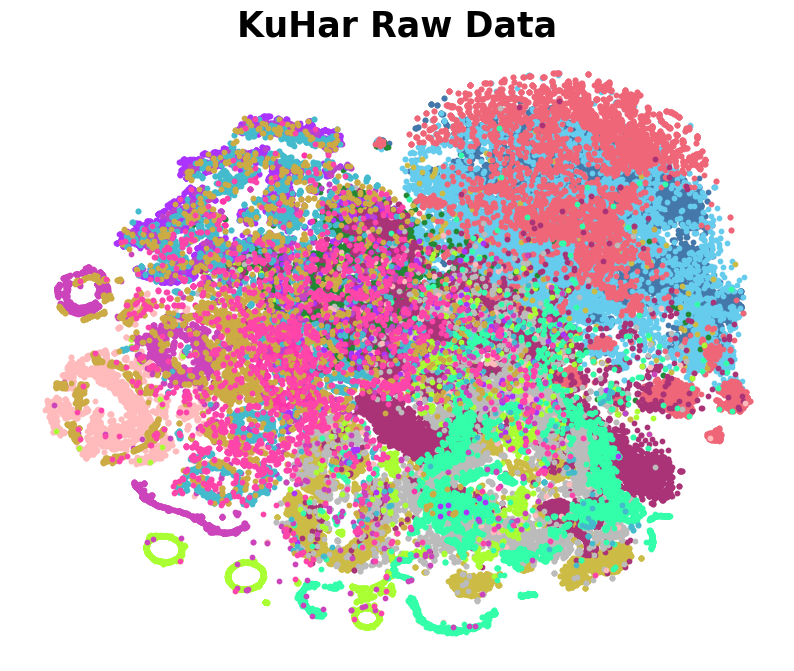

In [72]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377", 
    "#BBBBBB", "#FFBBBB", "#AAFF33", "#33FFAA", "#AA33FF", "#FF33AA",
    "#BB44CC", "#CC44BB", "#44BBCC", "#CCAA44", "#FF44AA", "#AAFF44"
]
dic = {
    0: 'stand', 1: 'sit', 2: 'talk-sit', 3: 'talk-stand', 4: 'stand-sit', 5: 'lay', 6: 'lay-stand',
    7: 'pick', 8: 'jump', 9: 'push-up', 10: 'sit-up', 11: 'walk', 
    12: 'walk-backward', 13: 'walk-circle', 14: 'run', 15: 'stair-up', 16: 'stair-down', 17: 'table-tennis'
}
plt.figure(figsize=(10, 8))
for i in range(18):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
plt.title('KuHar Raw Data', fontsize=25, fontweight='bold') 
#plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))

plt.axis('off')

# Salvar a figura

plt.savefig('KuHar_Raw.png', dpi=300)

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.show()

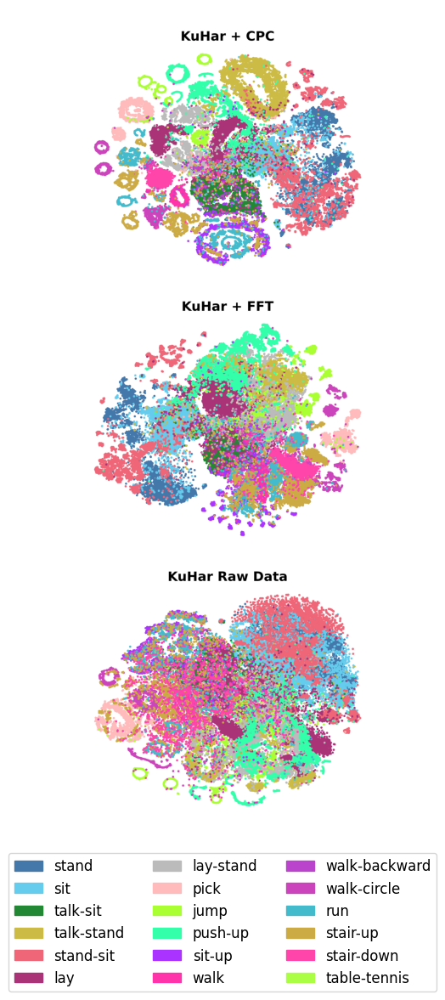

In [78]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as mpatches

# Carregar as imagens
img1 = mpimg.imread('KuHar_CPC.png')
img2 = mpimg.imread('KuHar_FFT.png')
img3 = mpimg.imread('KuHar_Raw.png')

# Cores e dicionário de atividades
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", "#AA3377", 
    "#BBBBBB", "#FFBBBB", "#AAFF33", "#33FFAA", "#AA33FF", "#FF33AA",
    "#BB44CC", "#CC44BB", "#44BBCC", "#CCAA44", "#FF44AA", "#AAFF44"
]
activities = {
    0: 'stand', 1: 'sit', 2: 'talk-sit', 3: 'talk-stand', 4: 'stand-sit', 5: 'lay', 6: 'lay-stand',
    7: 'pick', 8: 'jump', 9: 'push-up', 10: 'sit-up', 11: 'walk', 
    12: 'walk-backward', 13: 'walk-circle', 14: 'run', 15: 'stair-up', 16: 'stair-down', 17: 'table-tennis'
}

# Criar um subplot com uma coluna e três linhas
fig, axs = plt.subplots(3, 1, figsize=(6, 18))  # Ajustar o tamanho da figura para ter mais altura

# Exibir as imagens nos subplots
axs[0].imshow(img1)
axs[0].axis('off')
#axs[0].set_title('UCI_CPC.png', fontsize=12)

axs[1].imshow(img2)
axs[1].axis('off')
#axs[1].set_title('UCI_FFT.png', fontsize=12)

axs[2].imshow(img3)
axs[2].axis('off')
#axs[2].set_title('UCI_Raw.png', fontsize=12)

# Adicionar a legenda com pontos coloridos
legend_elements = [mpatches.Patch(color=colors[i], label=activities[i]) for i in range(len(activities))]
plt.figlegend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, 0.052), ncol=3, fontsize=12)

# Ajustar o layout
plt.tight_layout(pad=0, rect=[0, 0.05, 1, .6])  # Ajuste o `rect` para dar espaço para a legenda

# Salvar a imagem combinada
plt.savefig('kuhar_tsne_column.png')

# Mostrar o plot
plt.show()


In [79]:
import os
import torch
from model import Classifier

# Definir a variável de ambiente CUDA_VISIBLE_DEVICES
os.environ["CUDA_VISIBLE_DEVICES"] = "7"

class Args:
    def __init__(self):
        self.input_size = 6  # Número de canais de entrada (aceleração e giroscópio)
        self.kernel_size = 3
        self.padding = 1
        self.num_steps_prediction = 28
        self.batch_size = 64
        self.classifier_batch_size = 256
        self.window = 50  # Tamanho da janela
        self.overlap = 25  # Sobreposição da janela
        self.device = 'cuda' if torch.cuda.is_available() else 'cpu'  # Usar CUDA se disponível
        self.num_classes = 9 
        self.root_dir = '/workspaces/betania.silva/view_concatenated'  # Substitua pelo caminho real
        self.data_file = 'RealWorld_raw'  # Substitua pelo nome real do arquivo de dados
        self.saved_model = '/workspaces/betania.silva/ssl_tools/contrastive-predictive-coding-for-har/models/3_dataset/KuHar_RealWorld_k_28_lr_0.0005_bs_64.pkl'
        self.data_percentage = 100
args = Args()

# Verifique se o dispositivo está configurado corretamente
print(f'Usando o dispositivo: {args.device}')

classifier_model = Classifier(args)
# Carregar os pesos pré-treinados
classifier_model.load_pretrained_weights(args)
# Colocar o modelo em modo de avaliação
classifier_model.eval()


Usando o dispositivo: cuda
Loading the pre-trained weights


Classifier(
  (encoder): CPC(
    (encoder): Encoder(
      (encoder): Convolutional1DEncoder(
        (encoder): Sequential(
          (0): ConvBlock(
            (conv): Conv1d(6, 32, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (1): ConvBlock(
            (conv): Conv1d(32, 64, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
          (2): ConvBlock(
            (conv): Conv1d(64, 128, kernel_size=(3,), stride=(1,), padding=(1,), bias=False, padding_mode=reflect)
            (relu): ReLU()
            (dropout): Dropout(p=0.2, inplace=False)
          )
        )
      )
    )
    (rnn): GRU(128, 256, num_layers=2, batch_first=True, dropout=0.2)
    (Wk): ModuleList(
      (0-27): 28 x PredictionNetwork(
        (Wk): Linear(in_

In [80]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import numpy as np
import pandas as pd
from pathlib import Path
from dataset import load_dataset
# import TSNE
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt


In [81]:
# Passo 1: Obtenha os embeddings com o modelo pré-treinado
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

subset_train = data_loaders['train'].dataset.dataset  # Acessando o conjunto de dados original
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

embeddings = classifier_model.predict_features(inputs)
embeddings = embeddings.flatten(start_dim=1)
print("Embeddings", embeddings.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings.detach().numpy())


Data Raw (2263795, 6)
Data (90550, 50, 6)
Labels (90550,)
Data Raw (472518, 6)
Data (18899, 50, 6)
Labels (18899,)
Data Raw (587387, 6)
Data (23494, 50, 6)
Labels (23494,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 90550, 'val': 18899, 'test': 23494}
Dataset size for train: 90550
Dataset size for val: 18899
Dataset size for test: 23494
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6b73d00>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6b736a0>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6b72200>}
Embeddings torch.Size([90550, 12800])


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

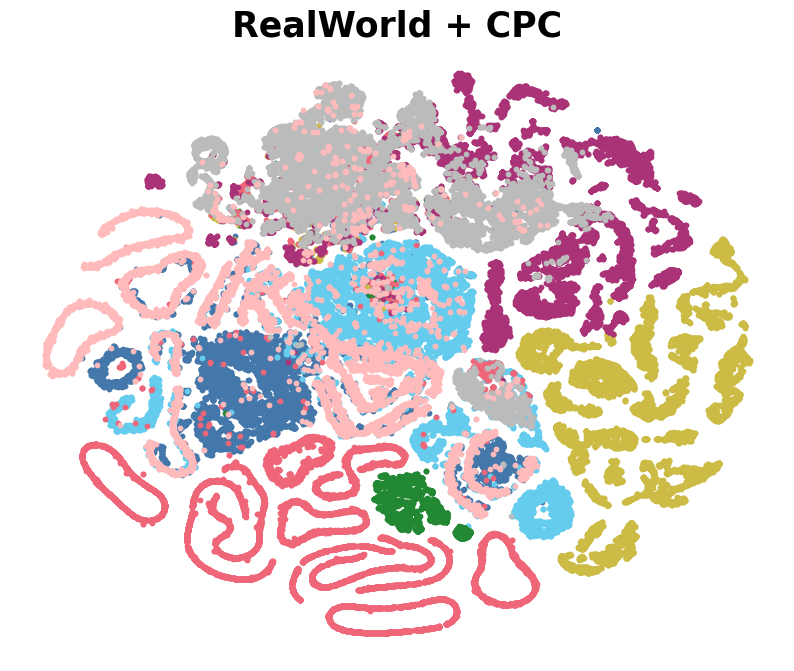

In [82]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", 
    "#AA3377", "#BBBBBB", "#FFBBBB"
]
dic = {
    0: 'climbingdown', 1: 'climbingup', 2: 'jumping', 
    3: 'lying', 4: 'running', 5: 'sitting', 6: 'standing', 7: 'walking'
}

plt.figure(figsize=(10, 8))
for i in range(8):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
plt.title('RealWorld + CPC', fontsize=25, fontweight='bold') 
#plt.legend(loc='lower center', ncol=3, bbox_to_anchor=(0.5, 0.03))
#plt.legend(fontsize=12)
# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.axis('off')

# Salvar a figura

plt.savefig('RealWorld_CPC.png', dpi=300)

plt.show()

In [83]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from dataset import load_dataset
from sklearn.manifold import TSNE

# Passo 1: Obtenha os dados brutos
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

# Converter para numpy array
inputs_np = inputs.detach().numpy()

# Aplicar FFT em cada uma das dimensões
fft_inputs = np.fft.fft(inputs_np, axis=1)  # Apply FFT along the second dimension
fft_magnitude = np.abs(fft_inputs)

print("FFT Magnitude", fft_magnitude.shape)

# Flatten the FFT magnitude array
embeddings = fft_magnitude.reshape(fft_magnitude.shape[0], -1)  # Flatten to (25241, 50*6)
print("Embeddings", embeddings.shape)

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(embeddings)


Data Raw (2263795, 6)
Data (90550, 50, 6)
Labels (90550,)
Data Raw (472518, 6)
Data (18899, 50, 6)
Labels (18899,)
Data Raw (587387, 6)
Data (23494, 50, 6)
Labels (23494,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 90550, 'val': 18899, 'test': 23494}
Dataset size for train: 90550
Dataset size for val: 18899
Dataset size for test: 23494
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3cf8700>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3cf9240>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9b3cf8400>}
FFT Magnitude (90550, 50, 6)
Embeddings (90550, 300)


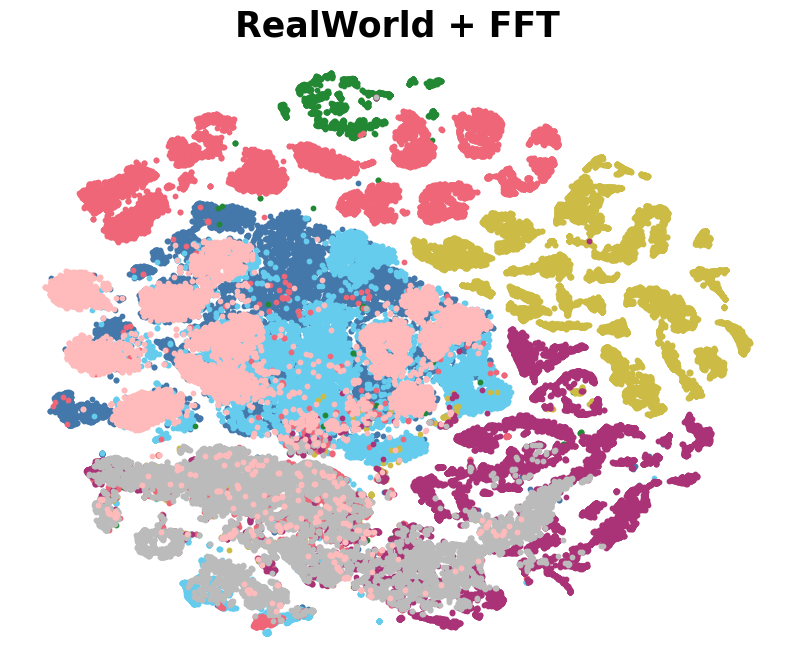

In [84]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", 
    "#AA3377", "#BBBBBB", "#FFBBBB"
]
dic = {
    0: 'climbingdown', 1: 'climbingup', 2: 'jumping', 
    3: 'lying', 4: 'running', 5: 'sitting', 6: 'standing', 7: 'walking'
}

plt.figure(figsize=(10, 8))
for i in range(8):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
#plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))
plt.title('RealWorld + FFT', fontsize=25, fontweight='bold') 
# plt.legend(fontsize=12)
# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')

plt.axis('off')

# Salvar a figura

plt.savefig('RealWorld_FFT.png', dpi=300)

plt.show()

In [85]:
# Passo 1: Obtenha os embeddings com DADOS BRUTOS
data_loaders, dataset_sizes = load_dataset(args)
print("Data Loaders", data_loaders)

inputs = data_loaders['train'].dataset.dataset
inputs = subset_train.data
inputs = torch.tensor(inputs, dtype=torch.float32)

labels = subset_train.labels

inputs = inputs.flatten(start_dim=1)

print("Embeddings", inputs.size())

# Passo 2: Reduza a dimensionalidade com t-SNE
tsne = TSNE(n_components=2, random_state=42)
embeddings_tsne = tsne.fit_transform(inputs.detach().numpy())

Data Raw (2263795, 6)
Data (90550, 50, 6)
Labels (90550,)
Data Raw (472518, 6)
Data (18899, 50, 6)
Labels (18899,)
Data Raw (587387, 6)
Data (23494, 50, 6)
Labels (23494,)
The batch size for train phase is: 64
The batch size for val phase is: 64
The batch size for test phase is: 64
Dataset sizes: {'train': 90550, 'val': 18899, 'test': 23494}
Dataset size for train: 90550
Dataset size for val: 18899
Dataset size for test: 23494
Data Loaders {'train': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6bd1b10>, 'val': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6bd0310>, 'test': <torch.utils.data.dataloader.DataLoader object at 0x7fb9d6bd0df0>}
Embeddings torch.Size([90550, 300])


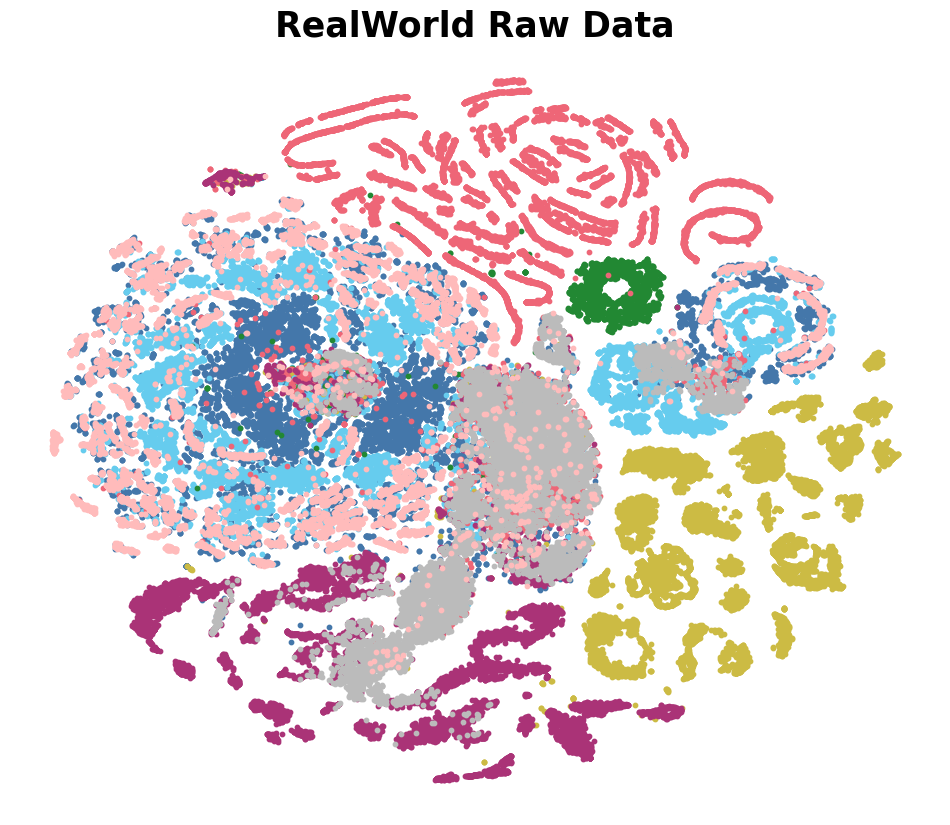

In [86]:
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", 
    "#AA3377", "#BBBBBB", "#FFBBBB"
]
dic = {
    0: 'climbingdown', 1: 'climbingup', 2: 'jumping', 
    3: 'lying', 4: 'running', 5: 'sitting', 6: 'standing', 7: 'walking'
}

plt.figure(figsize=(12, 10))
for i in range(8):
    plt.scatter(embeddings_tsne[labels == i+1, 0], embeddings_tsne[labels == i+1, 1], s=10, c=colors[i], label=f'{dic[i]}')
plt.title('RealWorld Raw Data', fontsize=25, fontweight='bold') 
#plt.legend(loc='lower center', ncol=6, bbox_to_anchor=(0.5, 0.03))
#plt.legend(fontsize=12)

plt.axis('off')

# Salvar a figura

plt.savefig('RealWorld_Raw.png', dpi=300)

# Aumentar o tamanho dos números nos eixos x e y
plt.xticks(fontsize=20, fontweight='bold')
plt.yticks(fontsize=20, fontweight='bold')
plt.show()

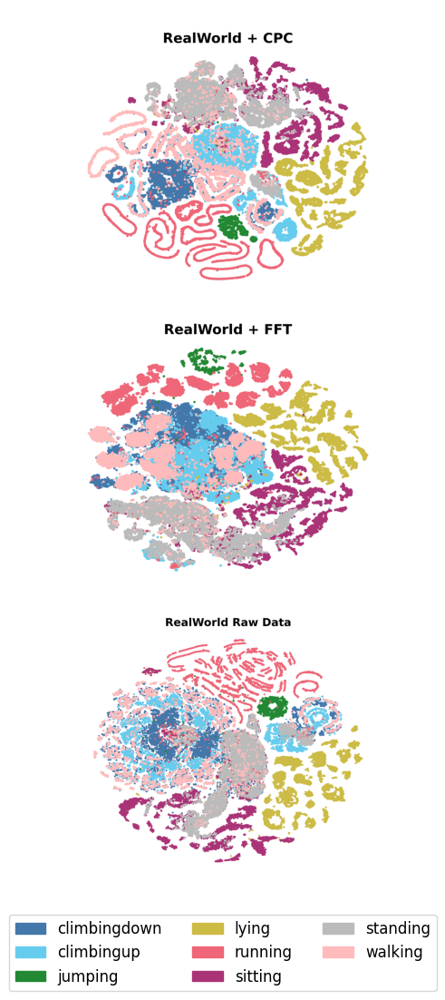

In [88]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.patches as mpatches

# Carregar as imagens
img1 = mpimg.imread('RealWorld_CPC.png')
img2 = mpimg.imread('RealWorld_FFT.png')
img3 = mpimg.imread('RealWorld_Raw.png')

# Cores e dicionário de atividades
colors = [
    "#4477AA", "#66CCEE", "#228833", "#CCBB44", "#EE6677", 
    "#AA3377", "#BBBBBB", "#FFBBBB"
]
activities = {
    0: 'climbingdown', 1: 'climbingup', 2: 'jumping', 
    3: 'lying', 4: 'running', 5: 'sitting', 6: 'standing', 7: 'walking'
}
# Criar um subplot com uma coluna e três linhas
fig, axs = plt.subplots(3, 1, figsize=(6, 18))  # Ajustar o tamanho da figura para ter mais altura

# Exibir as imagens nos subplots
axs[0].imshow(img1)
axs[0].axis('off')
#axs[0].set_title('UCI_CPC.png', fontsize=12)

axs[1].imshow(img2)
axs[1].axis('off')
#axs[1].set_title('UCI_FFT.png', fontsize=12)

axs[2].imshow(img3)
axs[2].axis('off')
#axs[2].set_title('UCI_Raw.png', fontsize=12)

# Adicionar a legenda com pontos coloridos
legend_elements = [mpatches.Patch(color=colors[i], label=activities[i]) for i in range(len(activities))]
plt.figlegend(handles=legend_elements, loc='upper center', bbox_to_anchor=(0.5, 0.05), ncol=3, fontsize=12)

# Ajustar o layout
plt.tight_layout(pad=0, rect=[0, 0.05, 1, .6])  # Ajuste o `rect` para dar espaço para a legenda

# Salvar a imagem combinada
plt.savefig('realworld_tsne_column.png')

# Mostrar o plot
plt.show()
